## import packages

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os 

# used for thresholds tuning with sliders
from ipywidgets import interact_manual
from IPython.display import display

from moviepy.editor import VideoFileClip
from IPython.display import HTML
# from tqdm import tqdm


## Functions for displaying photos

In [2]:
def read_img(img):
    img = cv2.imread(img) 
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

def show_image(image, title='Image', cmap_type='gray' , bgr2rgb=False):
    if bgr2rgb:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image, cmap = cmap_type)
    plt.title(title)
    plt.show()

def show_images(images, cols = 2, cmap=None, bgr2rgb=False):

    rows = (len(images)+1)//cols
    
    plt.figure(figsize=(20, 22))
    for i, image in enumerate(images):
        plt.subplot(rows, cols, i+1)
        # use gray scale color map if there is only one channel
        try:
            cmap = 'gray' if len(image.shape)==2 else cmap
        except AttributeError:
            cmap = None
            
        if bgr2rgb:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
        plt.imshow(image, cmap=cmap)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout(pad=0, h_pad=0, w_pad=0)
    plt.show()

## Displaying test_images

In [3]:
imgs_path = 'project_data/test_images'
# os.listdir(imgs_path)

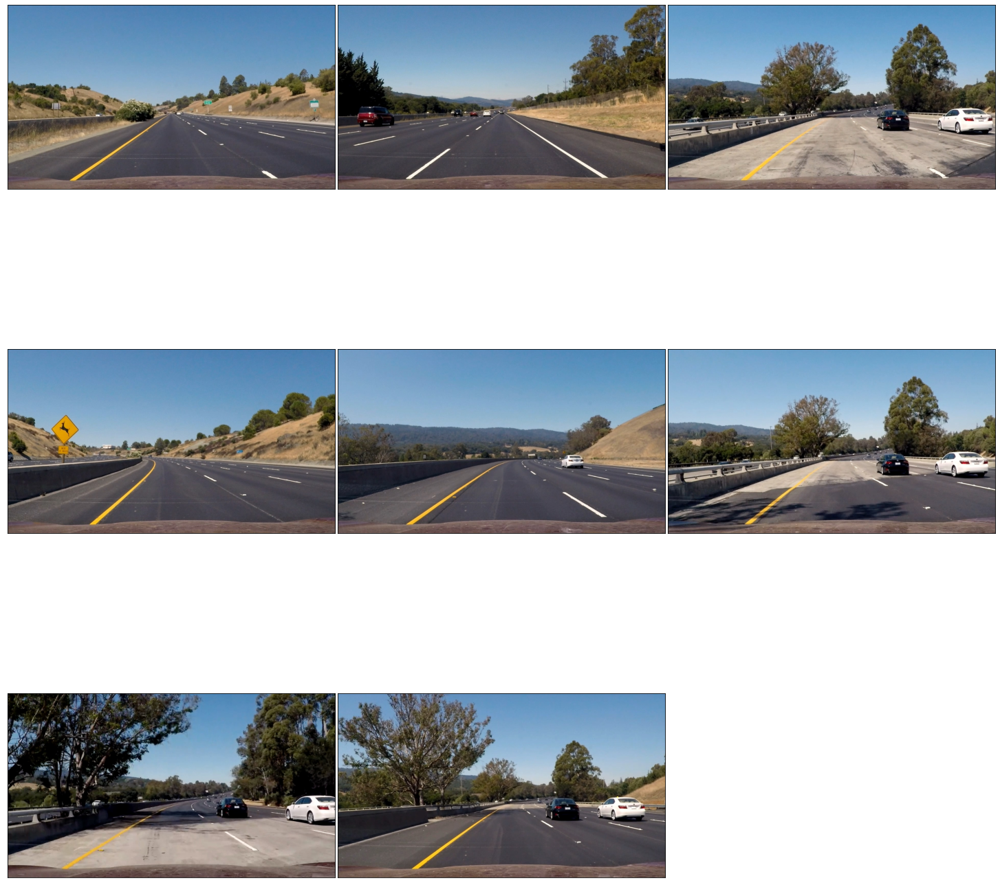

In [4]:
images = []
for path in os.listdir(imgs_path):
    if path.endswith(".jpg"):
        image = read_img(os.path.join(imgs_path, path))
        images.append(image)
show_images(images , 3)


In [5]:
img  = images[0]

## Perspective Transform

We now need to define a trapezoidal region in the 2D image that will go through a perspective transform to convert into a bird's eye view.

add_points -> specifing the 4 points of the window

add_lines  -> drawing the window using the specified 4 points

warper     -> Compute and apply perpective transform

unwarp     -> Compute and apply inverse perpective transform

In [6]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = -1
    radius = 15
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.circle(img2, (int(x0), int(y0)), radius, color, thickness)
    cv2.circle(img2, (int(x1), int(y1)), radius, color, thickness)
    cv2.circle(img2, (int(x2), int(y2)), radius, color, thickness)
    cv2.circle(img2, (int(x3), int(y3)), radius, color, thickness)

    return img2

def add_lines(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (int(x0), int(y0)), (int(x1), int(y1)), color, thickness)
    cv2.line(img2,(int(x1), int(y1)), (int(x2), int(y2)), color, thickness)
    cv2.line(img2, (int(x2), int(y2)), (int(x3), int(y3)), color, thickness)
    cv2.line(img2,(int(x3), int(y3)), (int(x0), int(y0)), color, thickness)
    return img2

In [7]:
h, w = img.shape[:2]

src = np.float32([
    [210, 700],
    [570, 460], 
    [705, 460], 
    [1075, 700]
])

dst = np.float32([
    [400, 720],
    [400, 0], 
    [w-400, 0], 
    [w-400, 720]
])


def warper(img):
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST )  # keep same size as input image

    return warped

def unwarp(img):
    
    # Compute and apply inverse perpective transform
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped = cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_NEAREST)
    
    return unwarped

#### applying prespective transform on a black image

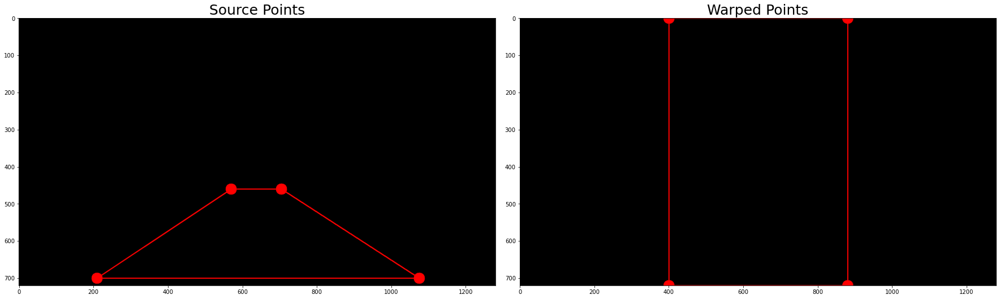

In [8]:
warped = warper(img)
imgSrc = np.zeros_like(warped)
imgDst = np.zeros_like(warped)
# imgSrc = np.zeros_like(img)

# add the points to the og and warped images 
src_points_img = add_points(imgSrc, src)
src_points_img = add_lines(src_points_img, src)
dst_points_warped = add_points(imgDst, dst)
dst_points_warped = add_lines(dst_points_warped, dst)

### Plot the source points on the original image and the warped image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(src_points_img)
ax1.set_title('Source Points', fontsize=25)
ax2.imshow(dst_points_warped)
ax2.set_title('Warped Points', fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### applying prespective transform on a test images 

straight_lines1.jpg


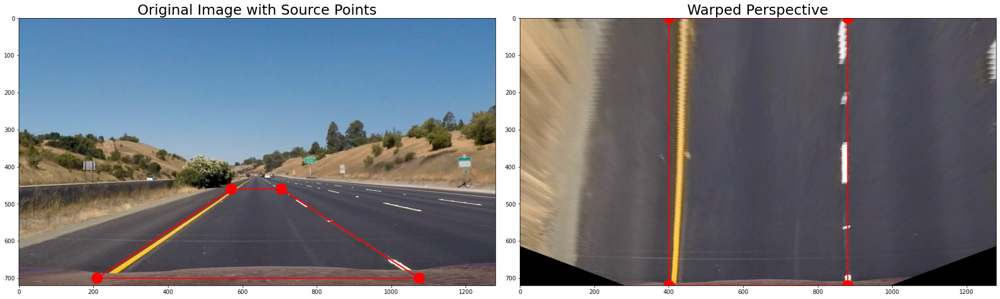

straight_lines2.jpg


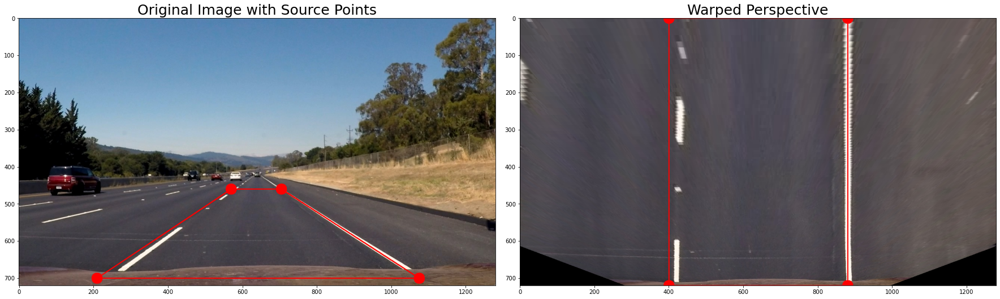

test1.jpg


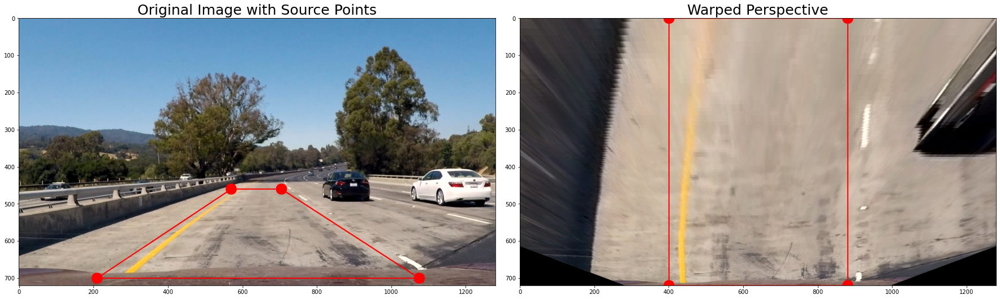

test2.jpg


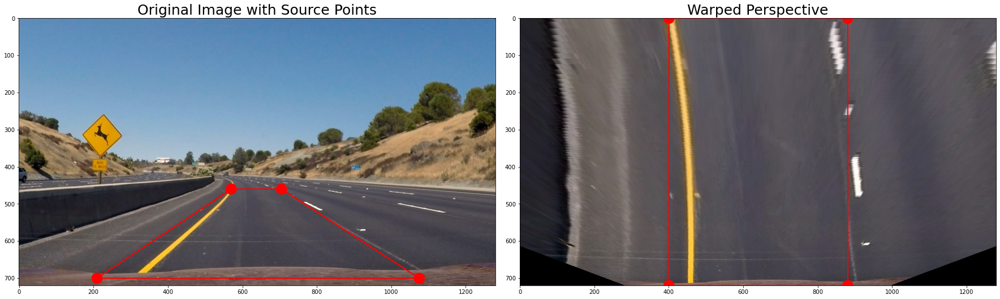

test3.jpg


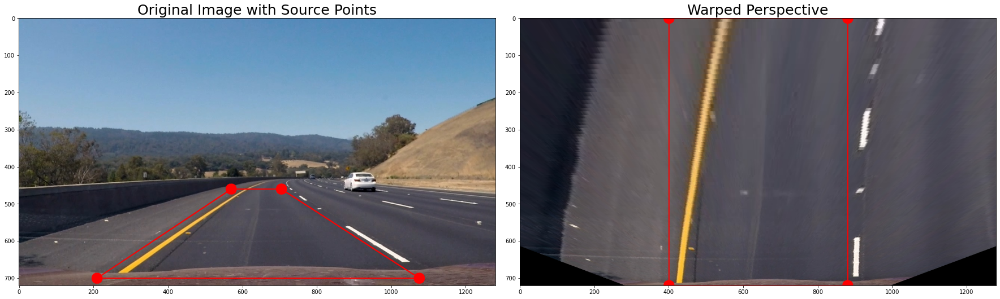

test4.jpg


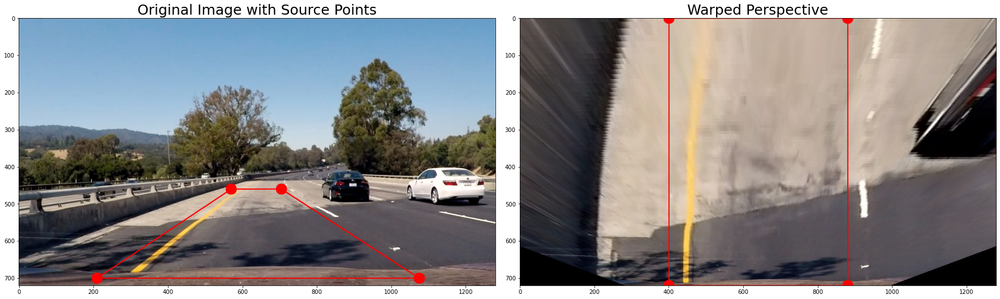

test5.jpg


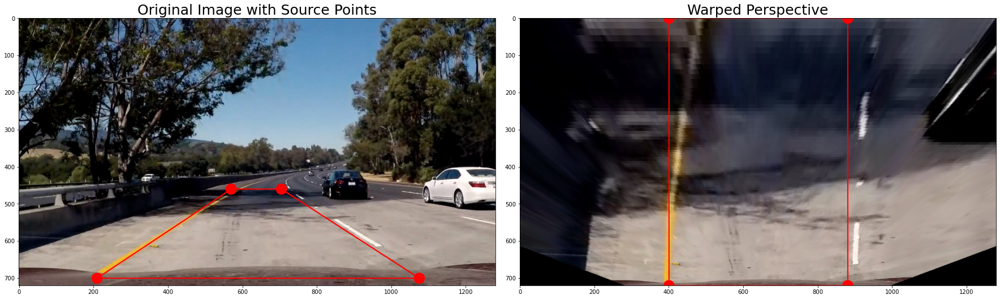

test6.jpg


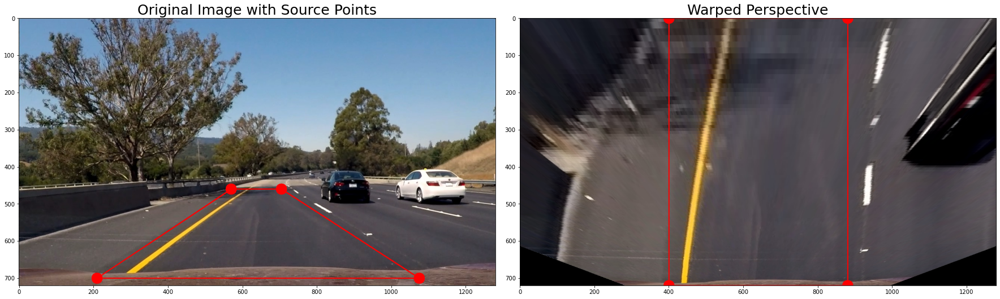

In [9]:
### get the straight test images from the test_images folder

for path in os.listdir(imgs_path):
    print(path)
    if path.endswith('.jpg'):
        image = cv2.imread(os.path.join(imgs_path, path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        warped = warper(image)
        
        src_points_img = add_points(image, src)
        src_points_img = add_lines(src_points_img, src)
        dst_points_warped = add_points(warped, dst)
        dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(src_points_img)
        ax1.set_title('Original Image with Source Points', fontsize=25)
        ax2.imshow(dst_points_warped)
        ax2.set_title('Warped Perspective', fontsize=25)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()
    
    

### Displaying different color spaces` channels on form of gray image 
(RGB, HLS, HSV, LAB, LUV) to choose the best channel in each color space 

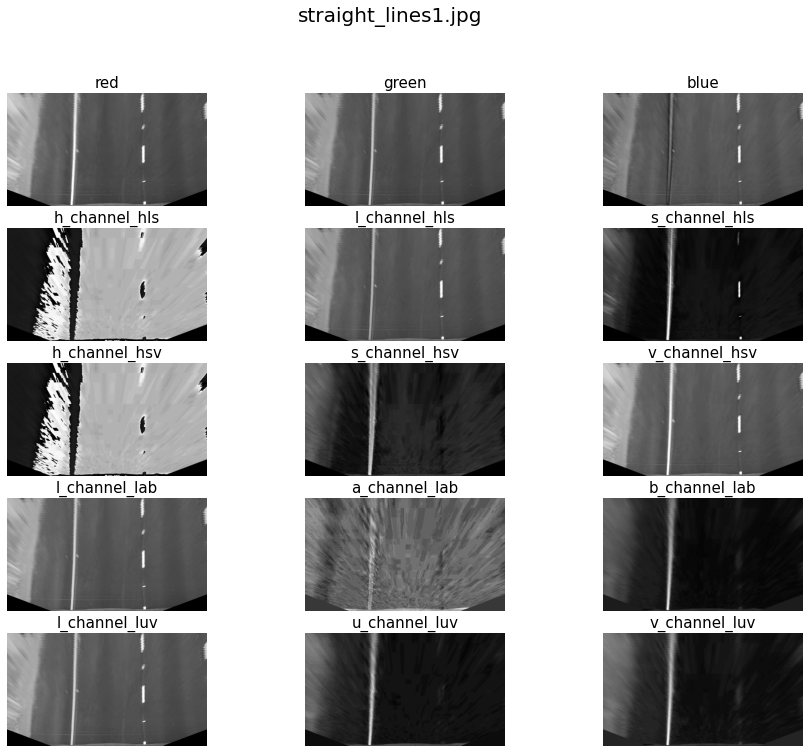

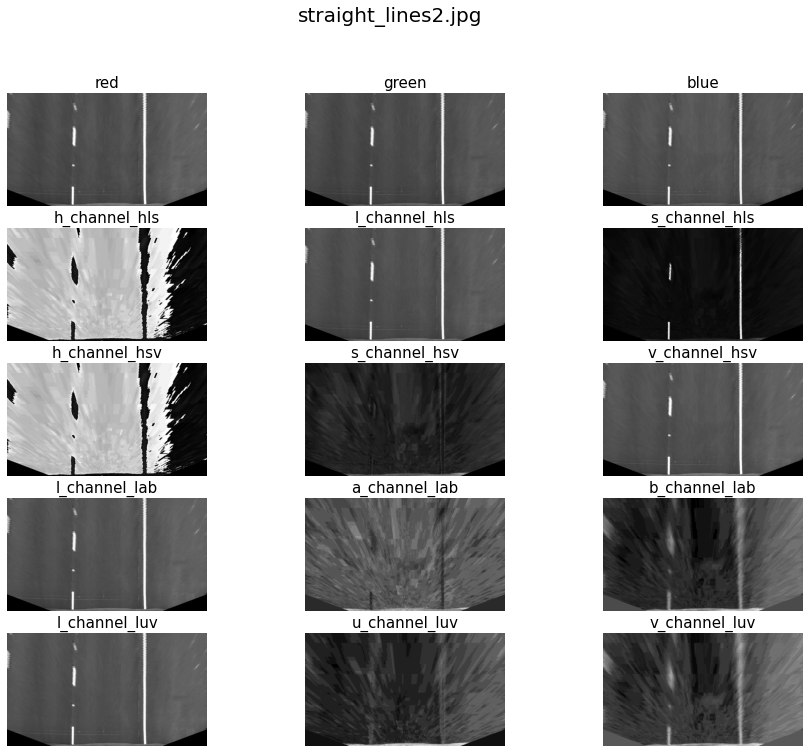

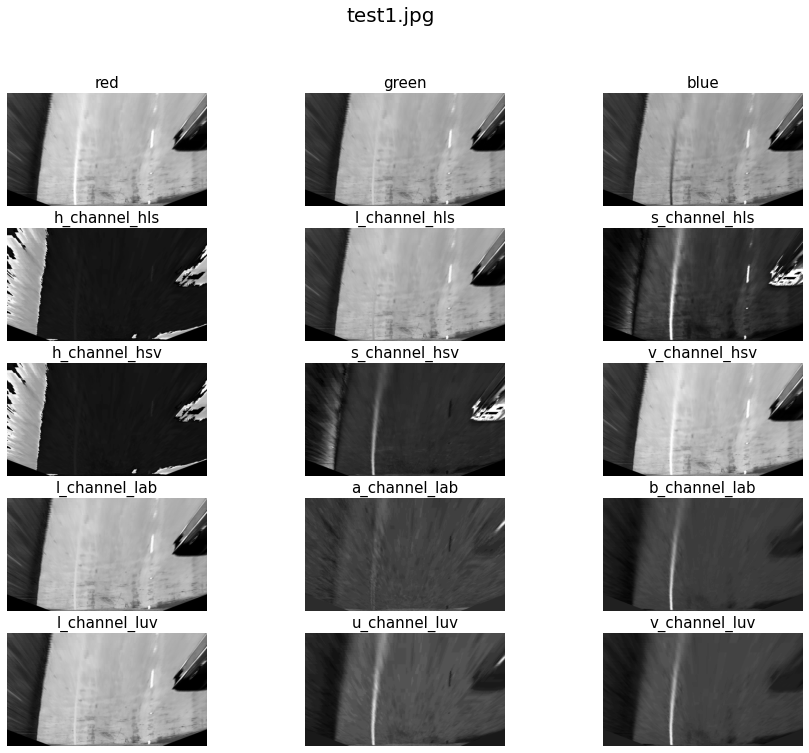

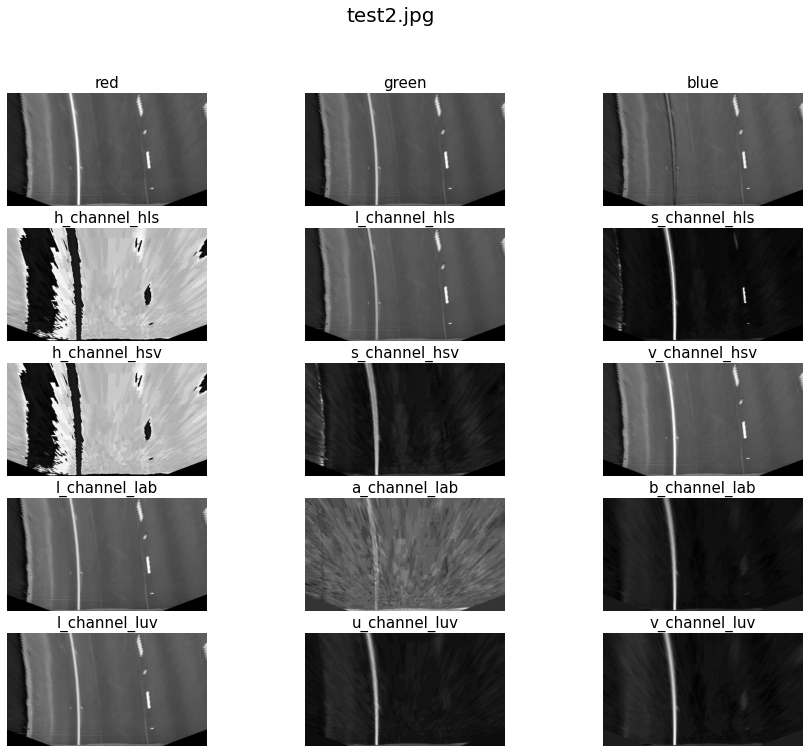

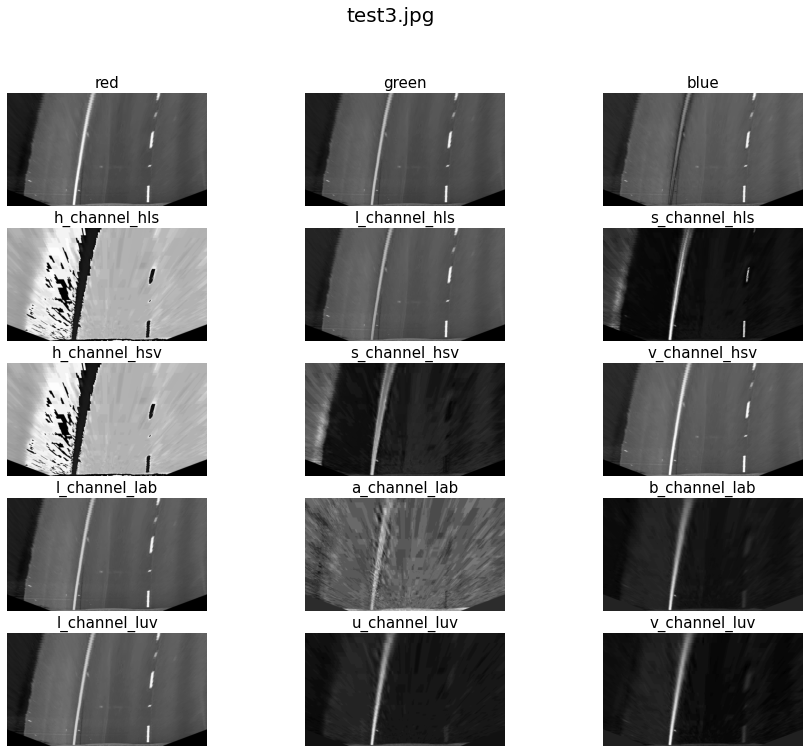

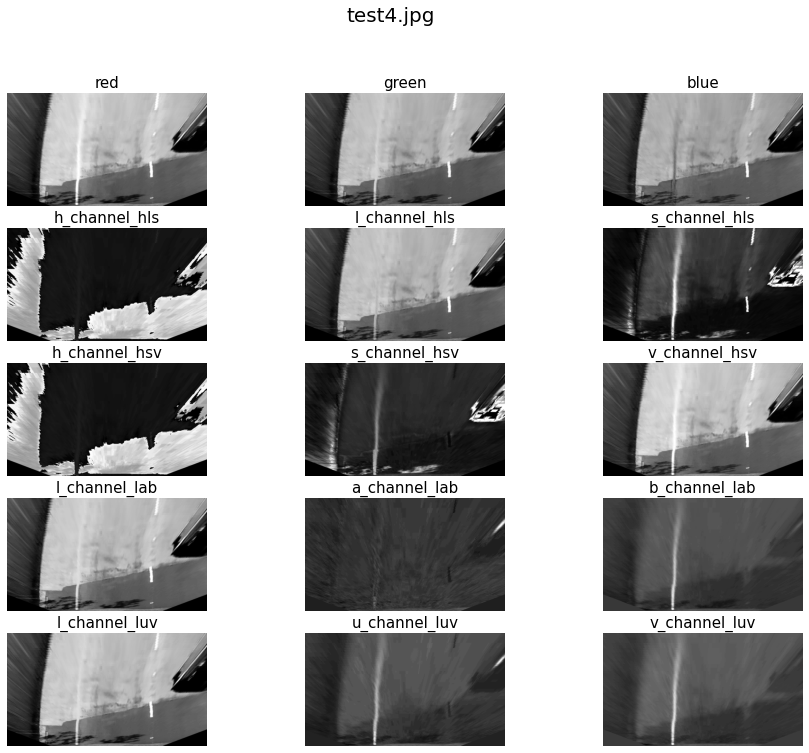

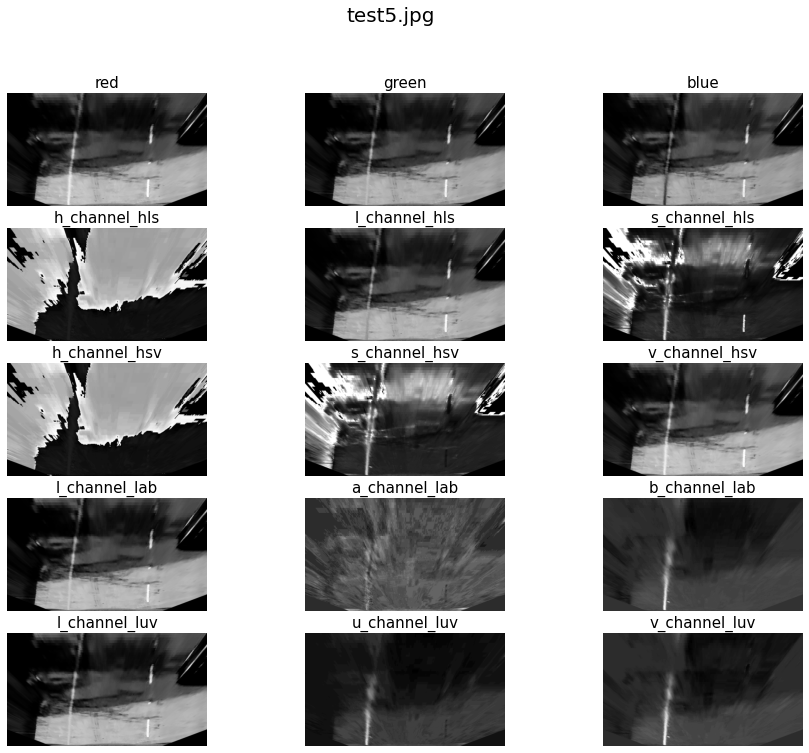

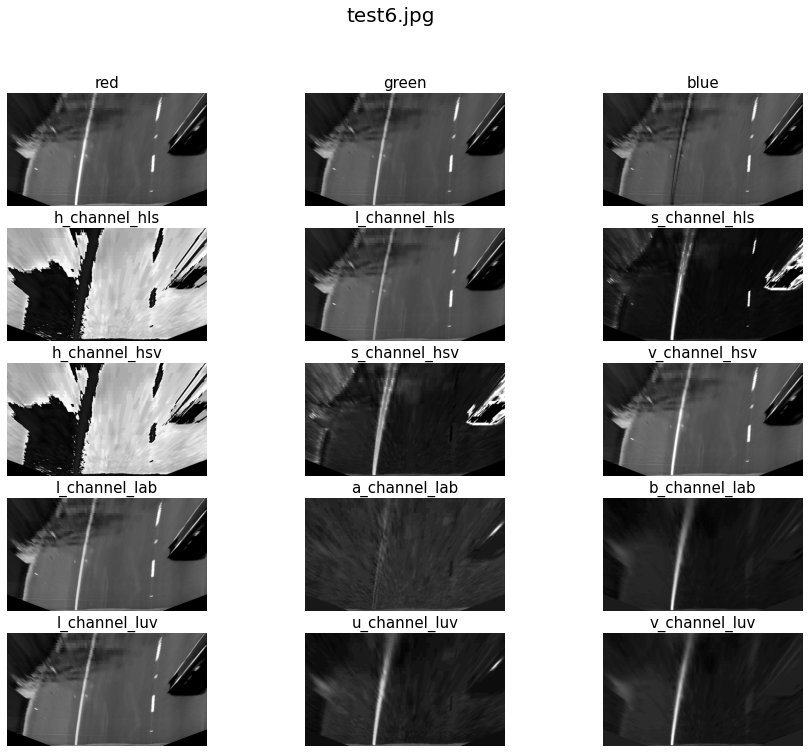

In [10]:

for path in os.listdir(imgs_path):
    img = read_img(os.path.join(imgs_path, path))

    warped = warper(img)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    # Convert to LAB color space
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2Lab).astype(float)
    l_channel_lab = lab[:,:,0]
    a_channel_lab = lab[:,:,1]
    b_channel_lab = lab[:,:,2]
    
    # Convert to LUV color space
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2Luv).astype(float)
    l_channel_luv = luv[:,:,0]
    u_channel_luv = luv[:,:,1]
    v_channel_luv = luv[:,:,2]

    
    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9),(ax10, ax11, ax12),(ax13, ax14, ax15)) = plt.subplots(5, 3, figsize=(16, 12))
    f.suptitle(path, fontsize=20)
    
    # Plot RGB
    ax1.imshow(R, cmap='gray')
    ax1.set_title('red', fontsize=15)
    ax1.axis('off')
    ax2.imshow(G, cmap='gray')
    ax2.set_title('green', fontsize=15)
    ax2.axis('off')
    ax3.imshow(B, cmap='gray')
    ax3.set_title('blue', fontsize=15)
    ax3.axis('off')
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.axis('off')
    ax4.set_title('h_channel_hls', fontsize=15)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=15)
    ax5.axis('off')
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=15)
    ax6.axis('off')
    
    # Plot HSV colors
    ax7.imshow(h_channel_hsv, cmap='gray')
    ax7.axis('off')
    ax7.set_title('h_channel_hsv', fontsize=15)
    ax8.imshow(s_channel_hsv, cmap='gray')
    ax8.set_title('s_channel_hsv', fontsize=15)
    ax8.axis('off')
    ax9.imshow(v_channel_hsv, cmap='gray')
    ax9.set_title('v_channel_hsv', fontsize=15)
    ax9.axis('off')
    
    # Plot LAB
    ax10.imshow(l_channel_lab, cmap='gray')
    ax10.axis('off')
    ax10.set_title('l_channel_lab', fontsize=15)
    ax11.imshow(a_channel_lab, cmap='gray')
    ax11.axis('off')
    ax11.set_title('a_channel_lab', fontsize=15)
    ax12.imshow(b_channel_lab, cmap='gray')
    ax12.set_title('b_channel_lab', fontsize=15)
    ax12.axis('off')
    
    # Plot LUV
    ax13.imshow(l_channel_luv, cmap='gray')
    ax13.axis('off')
    ax13.set_title('l_channel_luv', fontsize=15)
    ax14.imshow(u_channel_luv, cmap='gray')
    ax14.set_title('u_channel_luv', fontsize=15)
    ax14.axis('off')
    ax15.imshow(v_channel_luv, cmap='gray')
    ax15.set_title('v_channel_luv', fontsize=15)
    ax15.axis('off')
    
    plt.subplots_adjust(hspace = .2, wspace=.001)

## choosing the useful channel in each color space (RGB, HLS, HSV, LAB, LUV)

RGB-> r_channel

HLS-> s_channel

HSV-> v_channel

LAB-> b_channel

LUV-> l_channel

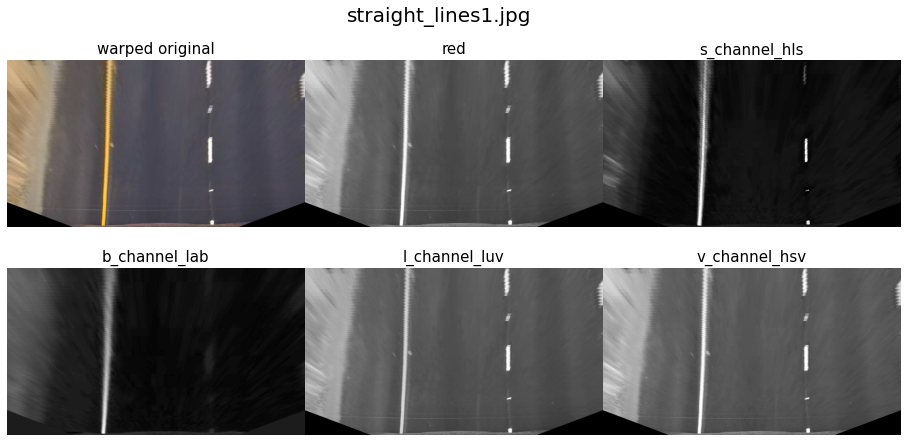

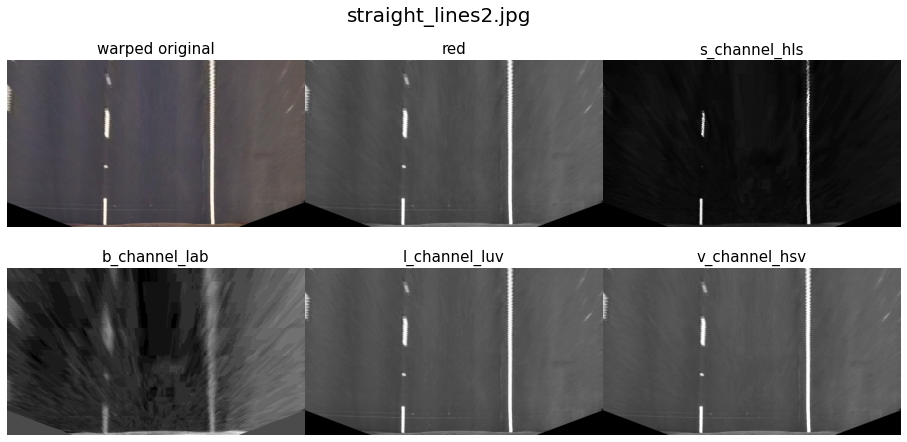

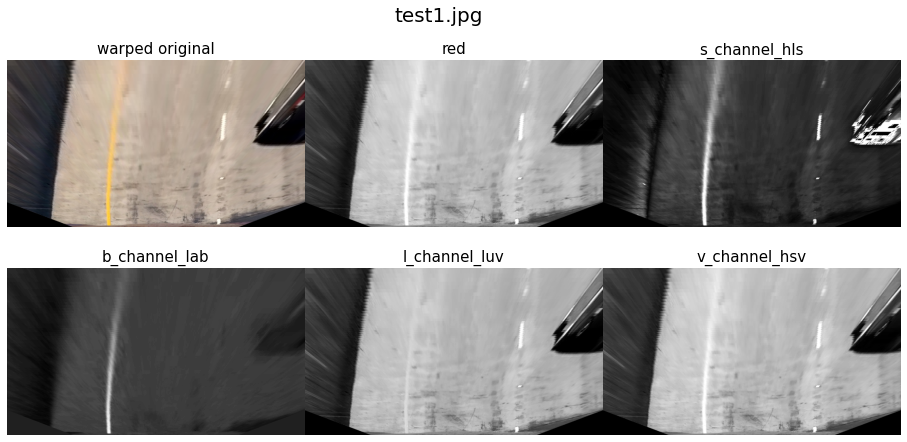

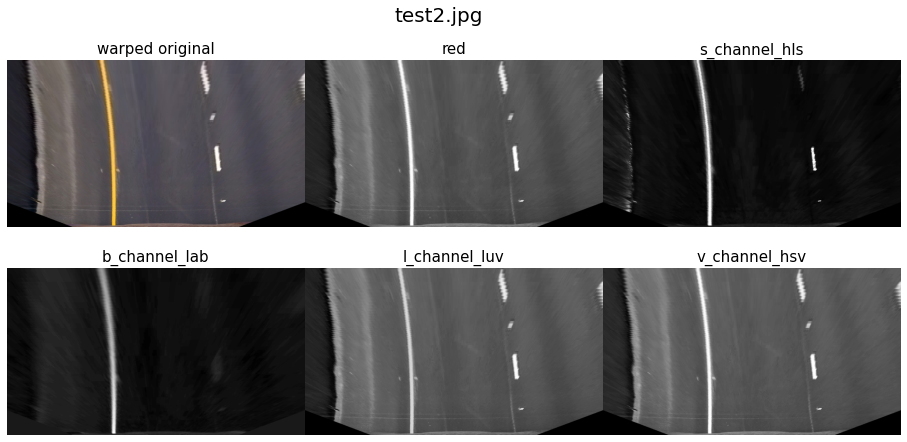

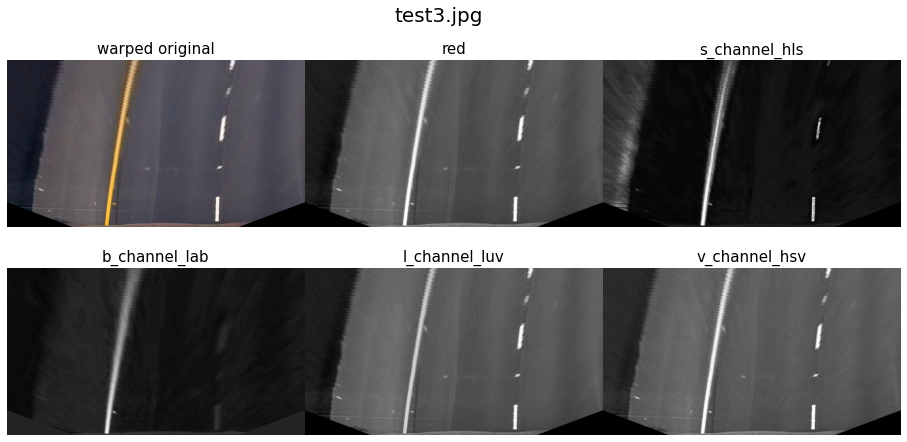

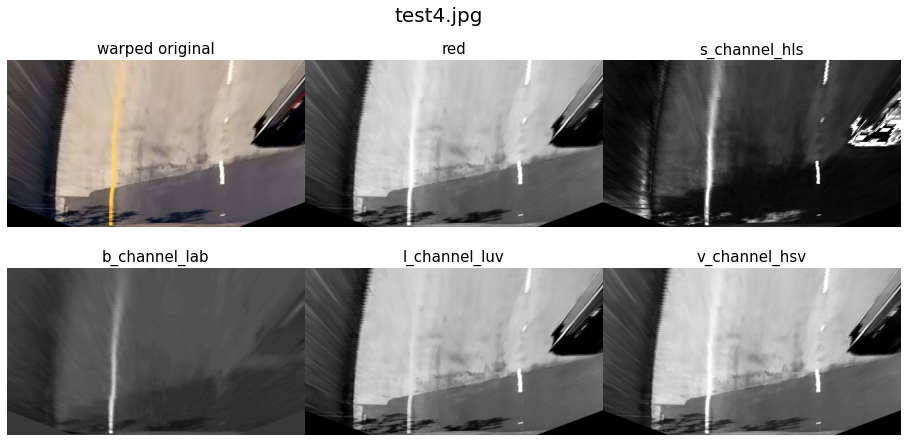

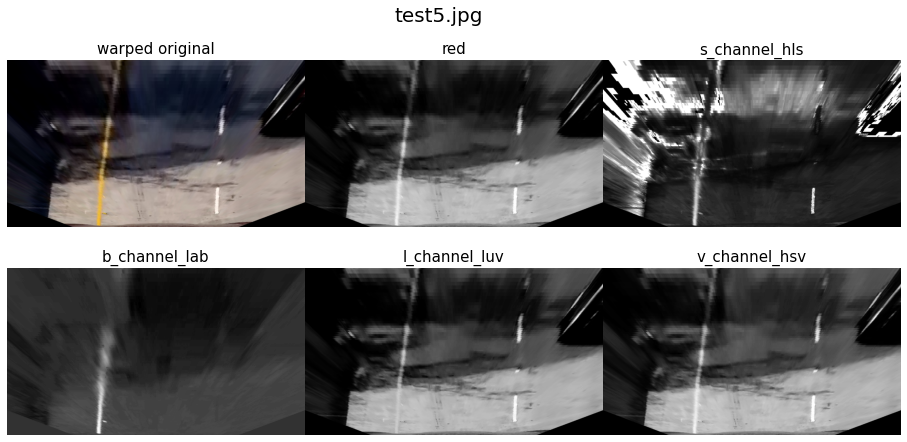

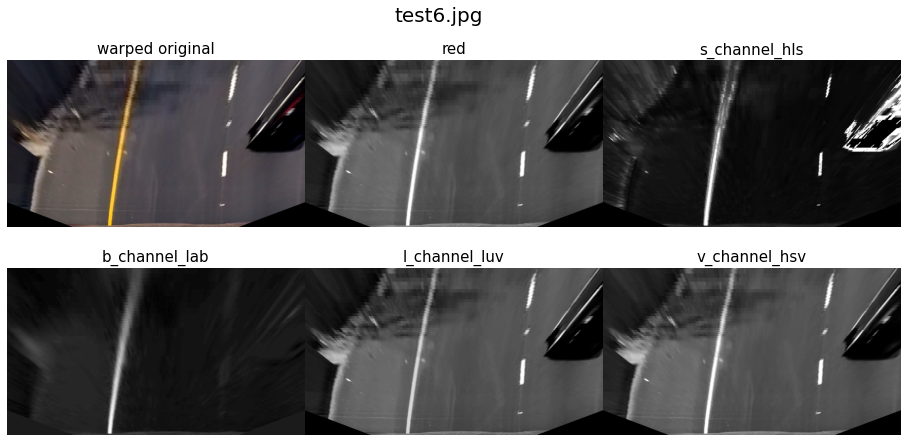

In [11]:
# plotting useful channels
for path in os.listdir(imgs_path):
    img = read_img(os.path.join(imgs_path, path))

    warped = warper(img)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    # Convert to LAB color space
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2Lab).astype(float)
    l_channel_lab = lab[:,:,0]
    a_channel_lab = lab[:,:,1]
    b_channel_lab = lab[:,:,2]
    
    # Convert to LUV color space
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2Luv).astype(float)
    l_channel_luv = luv[:,:,0]
    u_channel_luv = luv[:,:,1]
    v_channel_luv = luv[:,:,2]

    
    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(16, 7))
    f.suptitle(path, fontsize=20)

    ax1.imshow(warped)
    ax1.set_title('warped original', fontsize=15)
    ax1.axis('off')
    
    ax2.imshow(R, cmap='gray')
    ax2.set_title('red', fontsize=15)
    ax2.axis('off')
    
    ax3.imshow(s_channel_hls, cmap='gray')
    ax3.set_title('s_channel_hls', fontsize=15)
    ax3.axis('off')

    ax4.imshow(b_channel_lab, cmap='gray')
    ax4.set_title('b_channel_lab', fontsize=15)
    ax4.axis('off')
    
    ax5.imshow(l_channel_luv, cmap='gray')
    ax5.axis('off')
    ax5.set_title('l_channel_luv', fontsize=15)
    
    ax6.imshow(v_channel_hsv, cmap='gray')
    ax6.axis('off')
    ax6.set_title('v_channel_hsv', fontsize=15)

    
    plt.subplots_adjust(hspace = .2, wspace=.001)

## sobel gradient 
We use the Sobel operator to identify gradients, that is change in color intensity in the image. Higher values would denote strong gradients, and therefore sharp changes in color.

In [12]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def calc_sobel(img, sx=False, sy=False, sobel_kernel=5, thresh=(25, 200)):
    
    # Convert to grayscale - sobel can only have one color channel
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Take the sobel gradient in x and y
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    
    if sx:
        abs_sobel = np.absolute(sobelx)
        scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    elif sy:
        abs_sobel = np.absolute(sobely)
        scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    else:
        # Calculate the magnitude 
        mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    
        # Scale to 8-bit (0 - 255) and convert to type = np.uint8
        scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))

    # Create a binary mask where mag thresholds are me
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1   

    return sxbinary


### Displaying original img, original warped img, sobel img, unwarped_sobel img

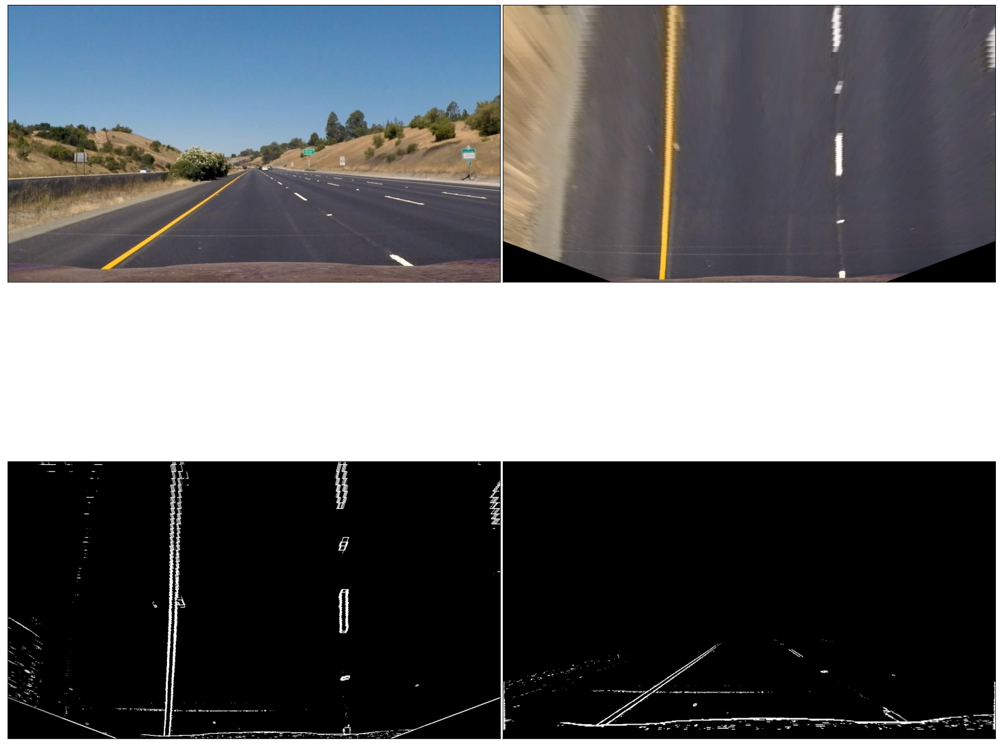

In [13]:

img = images[0]

warped = warper(img)
sobel = calc_sobel(warped)
unwarped_sobel = unwarp(sobel)

show_images([img, warped, sobel, unwarped_sobel] , 2)

# Canny Filter

In [14]:

def canny(img, low_threshold, high_threshold):
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size=5):
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def run_canny(img, kernel_size=5, low_thresh=50, high_thresh=150):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Apply a Gaussian Blur
    gausImage = gaussian_blur(gray, kernel_size)

    # Run the canny edge detection
    cannyImage = canny(gausImage, low_thresh, high_thresh)

    return cannyImage


### Displaying original img, original warped img, canny warped img, unwarped_canny img

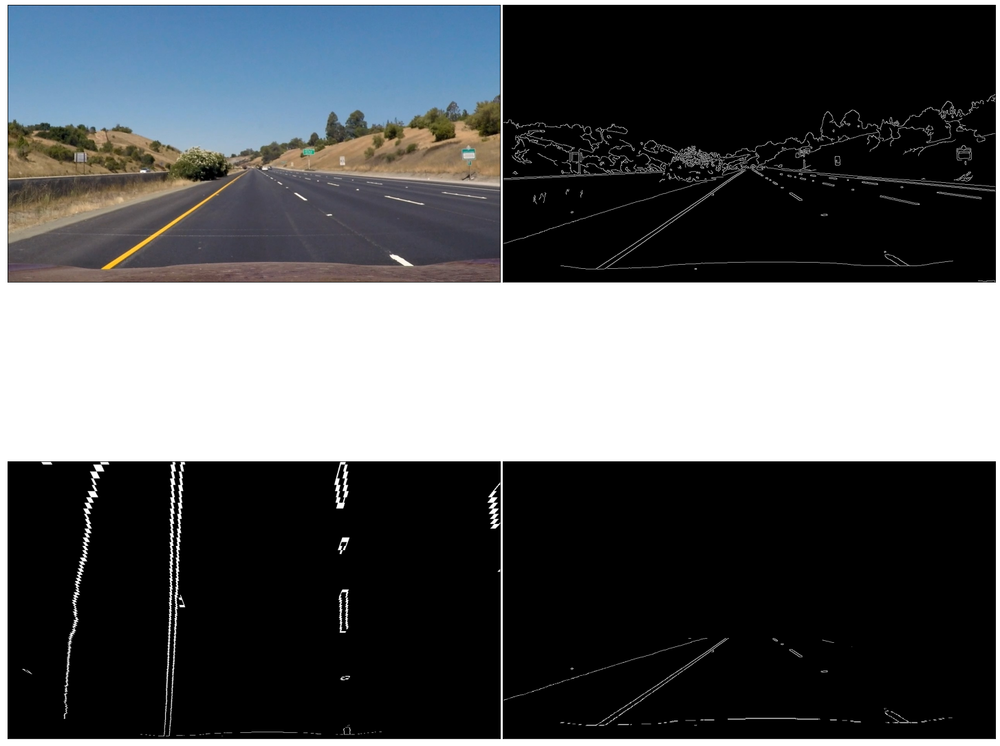

In [15]:

img = images[0]

cannyImage = run_canny(img, kernel_size=5, low_thresh=50, high_thresh=150)
warped_canny = warper(cannyImage)
unwarped_canny = unwarp(warped_canny)

show_images([img, cannyImage , warped_canny , unwarped_canny])

## Color Thresholding

We experiment with different color spaces and try out some thresolding values to identify the best parameters and most suitable color space to pick.

In [16]:
def applyThreshold(channel, thresh):
    # Create an image of all zeros
    binary_output = np.zeros_like(channel)
    
    # Apply a threshold to the channel with inclusive thresholds 
    binary_output[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    
    return binary_output

def rgb_rthresh(img, thresh=(125, 255)):
    # Pull out the R channel - assuming that RGB was passed in
    channel = img[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

def hls_sthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the S channel
    channel = hls[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

def lab_bthresh(img, thresh=(125, 255)):
    # Convert to HLS
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    # Pull out the B channel
    channel = lab[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

def luv_lthresh(img, thresh=(125, 255)):
    # Convert to HLS
    luv = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    # Pull out the L channel
    channel = luv[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

### combining the resultes from applying threshold values in the specefied color space channels to get most efficient one 

In [17]:
def binaryPipeline(img, show_images=False, 
                   sobel_kernel_size=7, sobel_thresh_low=35, sobel_thresh_high=50, 
                   canny_kernel_size=5 , canny_thresh_low=50, canny_thresh_high=150, 
                   r_thresh_low=225, r_thresh_high=255, 
                   s_thresh_low=220, s_thresh_high=250, 
                   b_thresh_low=175, b_thresh_high=255, 
                   l_thresh_low=215, l_thresh_high=255 
                  ):

    warped = warper(img)
    
    ### COLOR SELECTION
    r = rgb_rthresh(warped, thresh=(r_thresh_low, r_thresh_high))
    s = hls_sthresh(warped, thresh=(s_thresh_low, s_thresh_high))
    b = lab_bthresh(warped, thresh=(b_thresh_low, b_thresh_high))
    l = luv_lthresh(warped, thresh=(l_thresh_low, l_thresh_high))
    
    ### EDGE DETECTION
    sobel = calc_sobel(warped, sx=True, sobel_kernel=sobel_kernel_size, thresh=(sobel_thresh_low, sobel_thresh_high))
    
    # Run canny edge detector
    # canny_ = run_canny(warped, kernel_size=canny_kernel_size, low_thresh=canny_thresh_low, high_thresh=canny_thresh_high)
    
    ### Create plots if we want them
    if show_images:
        # f, (ax1, ax2, ax3, ax4, ax5 , ax6) = plt.subplots(1, 6, figsize=(16, 7))
        f, (ax1, ax2, ax3, ax4, ax5 ) = plt.subplots(1, 5, figsize=(16, 7))
        f.tight_layout()
        
        ax1.set_title('r', fontsize=10)
        ax1.axis('off')
        ax1.imshow(r, cmap='gray')
        
        ax2.set_title('s', fontsize=15)
        ax2.axis('off')
        ax2.imshow(s, cmap='gray')
        
        ax3.set_title('b', fontsize=15)
        ax3.axis('off')
        ax3.imshow(b, cmap='gray')

        ax4.set_title('l', fontsize=15)
        ax4.axis('off')
        ax4.imshow(l, cmap='gray')

        ax5.set_title('sobel', fontsize=15)
        ax5.axis('off')
        ax5.imshow(sobel, cmap='gray')

        # ax6.set_title('canny', fontsize=15)
        # ax6.axis('off')
        # ax6.imshow(canny_, cmap='gray')

    
    # combine these layers
    combined_binary = np.zeros_like(r)
    combined_binary[ (r == 1) | (s == 1) | (b == 1) | (l == 1) | (sobel == 1)] = 1
    
    return combined_binary

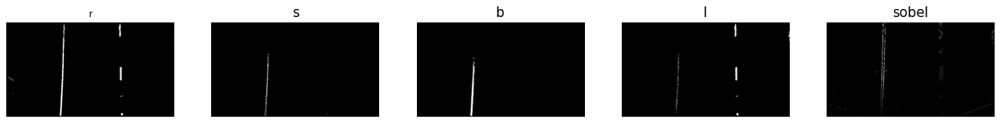

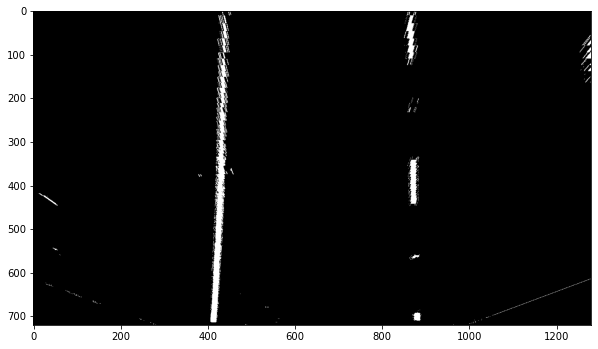

In [20]:
combined = binaryPipeline(img, show_images=True)

plt.figure(figsize=(10,10))
plt.imshow(combined,cmap='gray')
plt.show()


### interactive_mask 
to manually tune the value of each parameter (thresholds) with sliders

In [21]:
img = images[4]
print(img.shape)
def interactive_mask(sobel_kernel_size=5 , 
                    sobel_thresh_low=50, sobel_thresh_high=150, 
                    r_thresh_low=225, r_thresh_high=255, 
                    s_thresh_low=225, s_thresh_high=240, 
                    b_thresh_low=175, b_thresh_high=255, 
                    l_thresh_low=225, l_thresh_high=255):
    
    
    combined = binaryPipeline(img=img, show_images=True, 
                sobel_kernel_size=sobel_kernel_size, 
                sobel_thresh_low=sobel_thresh_low, 
                sobel_thresh_high=sobel_thresh_high, 
                r_thresh_low=r_thresh_low, r_thresh_high=r_thresh_high, 
                s_thresh_low=s_thresh_low, s_thresh_high=s_thresh_high, 
                b_thresh_low=b_thresh_low, b_thresh_high=b_thresh_high, 
                l_thresh_low=l_thresh_low, l_thresh_high=l_thresh_high)
    
    
    plt.figure(figsize=(10,10))
    plt.imshow(combined,cmap='gray')

interact_manual(interactive_mask, sobel_kernel_size=(1,15,2),
                sobel_thresh_low=(0,255,5), sobel_thresh_high=(0,255,5),
                r_thresh_low=(0,255,5), r_thresh_high=(0,255,5), 
                s_thresh_low=(0,255,5), s_thresh_high=(0,255,5), 
                b_thresh_low=(0,255,5), b_thresh_high=(0,255,5), 
                l_thresh_low=(0,255,5), l_thresh_high=(0,255,5), 
        )

(720, 1280, 3)


interactive(children=(IntSlider(value=5, description='sobel_kernel_size', max=15, min=1, step=2), IntSlider(va…

<function __main__.interactive_mask(sobel_kernel_size=5, sobel_thresh_low=50, sobel_thresh_high=150, r_thresh_low=225, r_thresh_high=255, s_thresh_low=225, s_thresh_high=240, b_thresh_low=175, b_thresh_high=255, l_thresh_low=225, l_thresh_high=255)>

### Applying the pipline to all of the test images

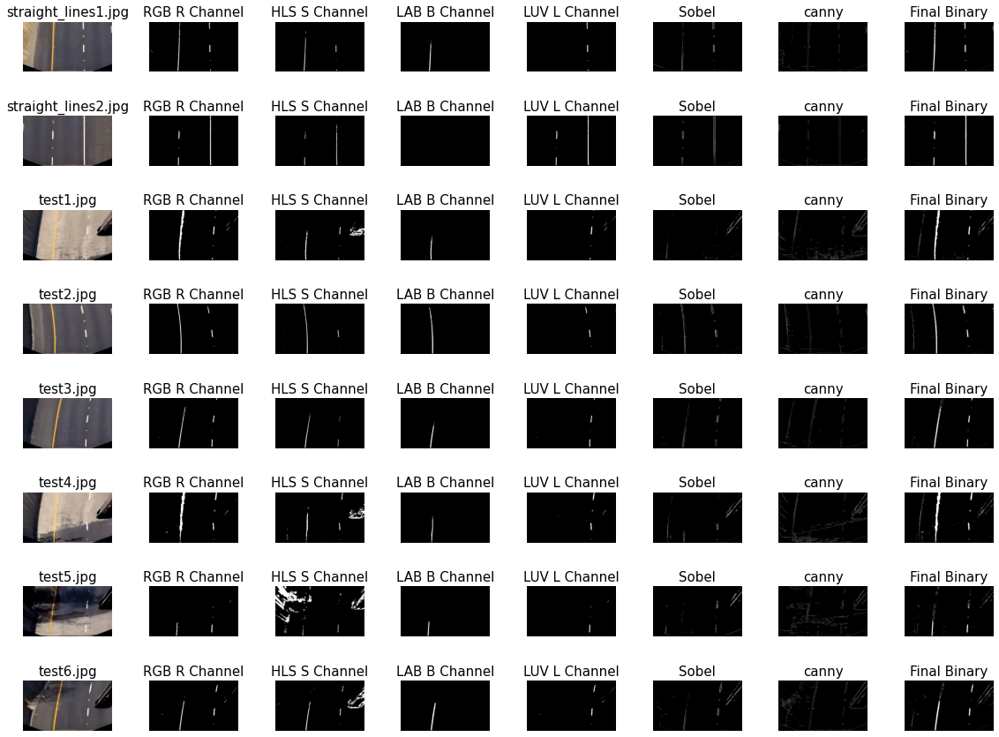

In [22]:

f, axs = plt.subplots(8, 8, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for path in os.listdir(imgs_path):
    # img = mpimg.imread(fname)
    img = read_img(os.path.join(imgs_path, path))
    
    # Run this through our binary pipeline
    warped = warper(img)
    
    combined = binaryPipeline(img, show_images=False)

    
    sobel_kernel_size=5 
    sobel_thresh_low=50
    sobel_thresh_high=150

    canny_kernel_size=7 
    canny_thresh_low=35
    canny_thresh_high=50

    r_thresh_low=225
    r_thresh_high=255

    s_thresh_low=200
    s_thresh_high=255

    b_thresh_low=175
    b_thresh_high=255

    l_thresh_low=225
    l_thresh_high=255
    
    # Get the Red and saturation images
    r = rgb_rthresh(warped, thresh=(r_thresh_low, r_thresh_high))
    s = hls_sthresh(warped, thresh=(s_thresh_low, s_thresh_high))
    b = lab_bthresh(warped, thresh=(b_thresh_low, b_thresh_high))
    l = luv_lthresh(warped, thresh=(l_thresh_low, l_thresh_high))
    sobel = calc_sobel(warped, sx=True, sobel_kernel=sobel_kernel_size, thresh=(sobel_thresh_low, sobel_thresh_high))
    canny_ = run_canny(warped, kernel_size=canny_kernel_size, low_thresh=canny_thresh_low, high_thresh=canny_thresh_high)

    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title( path , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(r, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(s, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(b, cmap='gray')
    axs[i].set_title('LAB B Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(l, cmap='gray')
    axs[i].set_title('LUV L Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(canny_, cmap='gray')
    axs[i].set_title('canny', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(combined, cmap='gray')
    axs[i].set_title('Final Binary', fontsize=15)
    i += 1

## detecting the two Lanes 

In [23]:

ym_per_pix = 3*8/720 # meters per pixel in y dimension, 8 lines (5 spaces, 3 lines) at 10 ft each = 3m
xm_per_pix = 3.7/550 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters

def calc_line_fits(img):

    ### Settings
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50


    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)

    # plt.figure()
    # plt.plot(histogram)
    
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fit_m, right_fit_m, out_img

In [24]:
def draw_fits(img, left_fit, right_fit):
    # calculates left and right and ploty and generates an image from the three of them then plots it using plt.imshow()
    
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    

    


    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))] , dtype=int)
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))], dtype=int)
    pts = np.hstack((pts_left, pts_right))

    cv2.polylines(color_warp, pts_right, False, (0,0,255), thickness=15)
    cv2.polylines(color_warp, pts_left, False, (255,0,0), thickness=15)

    
    return color_warp

### Loop through each image and send it to the pipeline

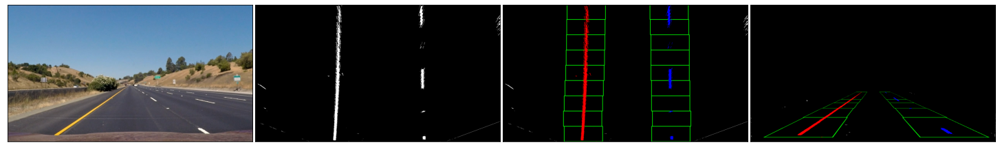

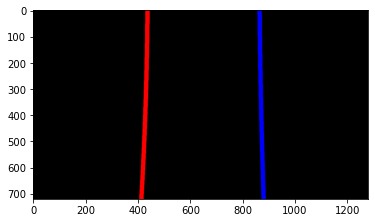

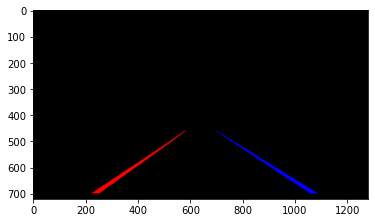

In [28]:


for path in os.listdir(imgs_path):
    
    img = read_img(os.path.join(imgs_path, path))
    
    binary_warped = binaryPipeline(img)
    
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    # left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    # right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    show_images([img ,binary_warped ,out_img , unwarp(out_img)] , cols = 4)
    
    out_img =  draw_fits(binary_warped, left_fit, right_fit)
    
    plt.imshow(out_img)
    plt.show()
    plt.imshow(unwarp(out_img))
    plt.show()
    break
    


### class Line()
contain functions to determine the redius of curvature of the line

In [29]:
class Line():
    
    def __init__(self):
        
        
        self.fit_px = []
        self.fit_m = None
        self.radius_of_curvature = None
        self.lane_to_camera = None
        self.diffs = np.array([0,0,0], dtype=float)
        self.ym_per_pix = 30/720

        # y_eval is where we want to evaluate the fits for the line radius calcuation 
        # for us it's at the bottom of the image for us, and because we know 
        # the size of our video/images we can just hardcode it
        self.y_eval = 720. * self.ym_per_pix

        # camera position is where the camera is located relative to the image
        # we're assuming it's in the middle
        self.camera_position = 640.

    def add_new_fit(self, new_fit_px, new_fit_m):

        # If this is our first line, then we will have to take it
        self.detected = True
        self.fit_px = new_fit_px
        self.fit_m = new_fit_m
        self.calc_radius()
        return

    def calc_radius(self):
        """
        left_fit and right_fit are assumed to have already been converted to meters
        """
        y_eval = self.y_eval
        fit = self.fit_m

        curve_rad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
        self.radius_of_curvature = curve_rad
        return


In [30]:
def get_center_dist(leftLine, rightLine):
    
    # grab the x and y fits at px 700 (slightly above the bottom of the image)
    y = 700.
    image_center = 640. * xm_per_pix
    
    leftPos = leftLine.fit_px[0]*(y**2) + leftLine.fit_px[1]*y + leftLine.fit_px[2]
    rightPos = rightLine.fit_px[0]*(y**2) + rightLine.fit_px[1]*y + rightLine.fit_px[2]
    lane_middle = int((rightPos - leftPos)/2.)+leftPos
    lane_middle = lane_middle * xm_per_pix
    
    mag = lane_middle - image_center
    if (mag > 0):
        head = "Right"
    else:
        head = "Left"
            
    return head, mag

def combine_radii(leftLine, rightLine):
    
    left = leftLine.radius_of_curvature
    right = rightLine.radius_of_curvature
    
    return np.average([left, right])

def create_final_image(img, binary_warped, leftLine, rightLine, show_images=False):
    
    left_fit = leftLine.fit_px
    right_fit = rightLine.fit_px
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)
    
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.5, 0)
    
    if show_images:
        plt.figure(figsize=(9,9))
        plt.imshow(color_warp)
        
        plt.figure(figsize=(9,9))
        plt.imshow(result)
    
    return result

def add_image_text(img, radius, head, center):
    
    # Add the radius and center position to the image
    font = cv2.FONT_HERSHEY_DUPLEX
    
    text = 'Radius of curvature: ' + '{:04.0f}'.format(radius) + 'm'
    cv2.putText(img, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    text = '{:03.2f}'.format(abs(center)) + 'm '+ head + ' of center'
    cv2.putText(img, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    
    return img


def write_on_img(img , text , pos):
    # writes the text on the top center of the image
    font = cv2.FONT_HERSHEY_DUPLEX
    cv2.putText(img, text, pos, font, 1.5, (255,0, 0), 2, cv2.LINE_AA)


In [31]:
def final_pipeline(img , leftLine = Line(), rightLine = Line()):
    
    
    binary_warped = binaryPipeline(img)
    
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    
    leftLine.add_new_fit(left_fit, left_fit_m)
    rightLine.add_new_fit(right_fit, left_fit_m)
    
    # get radius and center distance
    curve_rad = combine_radii(leftLine, rightLine)
    head, center = get_center_dist(leftLine, rightLine)

    # create the final image
    result = create_final_image(img, binary_warped, leftLine, rightLine)
    
    # add the text to the image 
    result = add_image_text(result, curve_rad, head, center)
    
    return result


In [32]:
def final_debug_pipline(img , leftLine = Line(), rightLine = Line()):
    

    binary_warped = binaryPipeline(img)

    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)


    leftLine.add_new_fit(left_fit, left_fit_m)
    rightLine.add_new_fit(right_fit, left_fit_m)

    # get radius and center distance
    curve_rad = combine_radii(leftLine, rightLine)
    head, center = get_center_dist(leftLine, rightLine)

    # create the final image
    result = create_final_image(img, binary_warped, leftLine, rightLine)
    
    
    binary_warped_3D = np.dstack((binary_warped,binary_warped,binary_warped))*255
    lines_only = draw_fits(binary_warped, left_fit, right_fit)
    
    # img >>>>>>>> warper(img) >>>> binary_warped_3D >>>> lines_only  >>>> out_img >>> result
    
    # perspective transform
    texts = ['1-original image', '2-warped image', '3-binary ', '4-sliding windows', '5-detected lines only' , '6-final image']
    
    row_1 =  np.hstack((img, warper(img) , binary_warped_3D))
    row_2 =  np.hstack((result , lines_only, out_img))
    debug_out =  np.vstack((row_1, row_2))
    
    #                                   (x  ,  y)
    write_on_img(debug_out , texts[0] , (500,50))
    write_on_img(debug_out , texts[1]  , (1700,50))
    write_on_img(debug_out , texts[2]  , (3000,50))
    write_on_img(debug_out , texts[3]  , (3000,800))
    write_on_img(debug_out , texts[4]  , (1700,800))
    write_on_img(debug_out , texts[5]  , (500,800))
    
    return debug_out

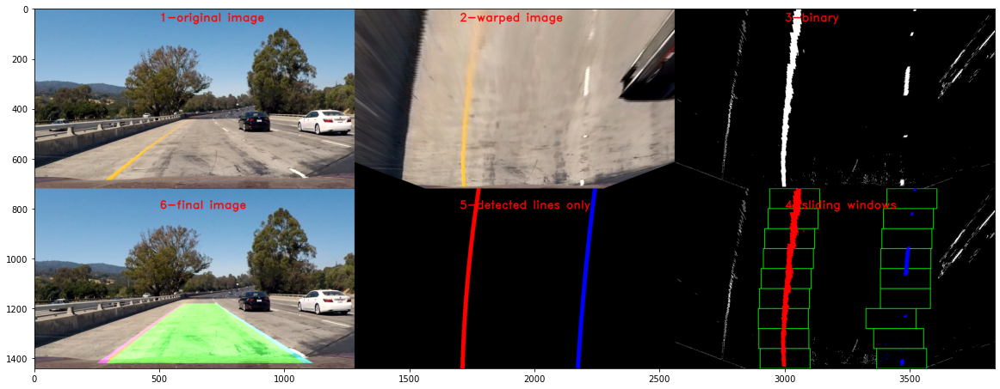

In [33]:
### testing final__debug_pipline
plt.figure(figsize=(20,20))
plt.imshow(final_debug_pipline(images[2]))
plt.show()

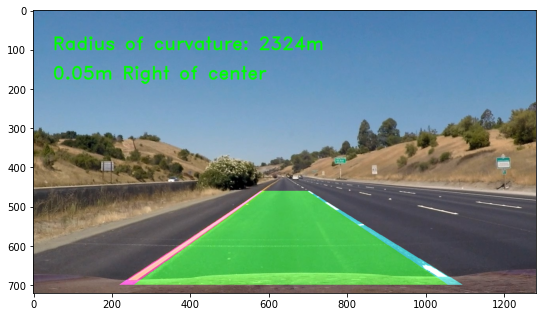

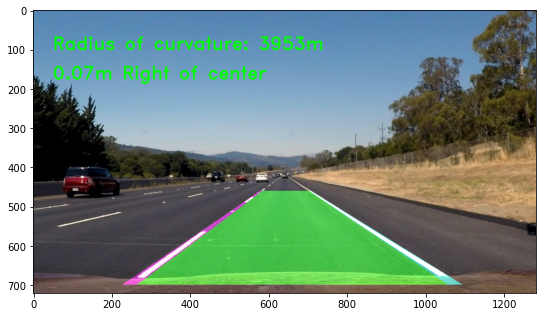

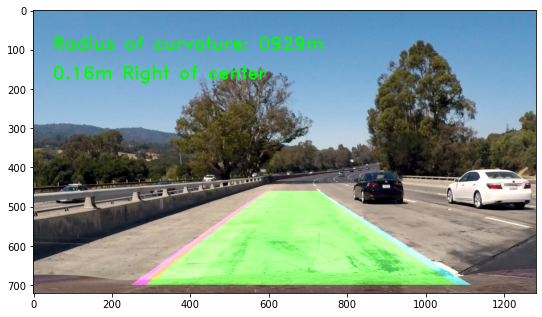

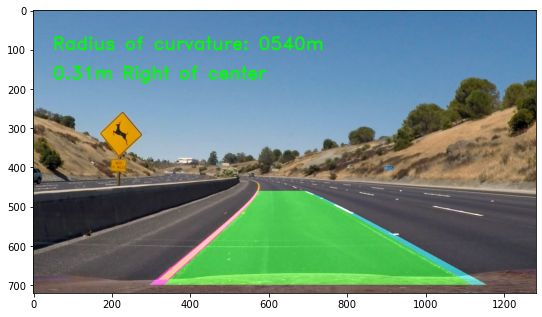

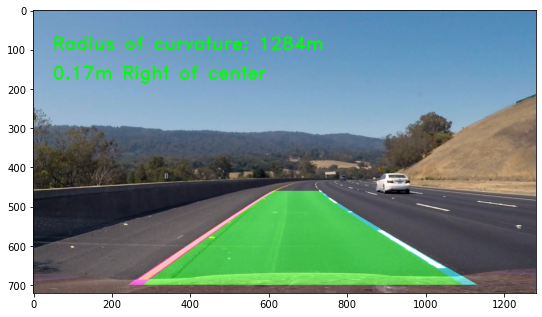

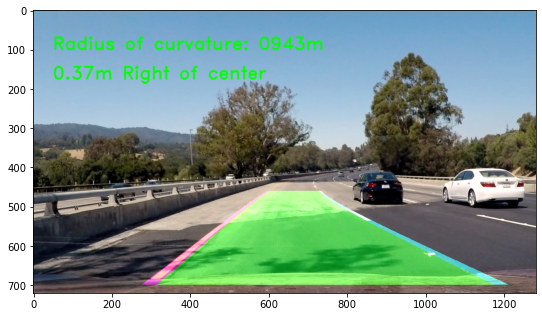

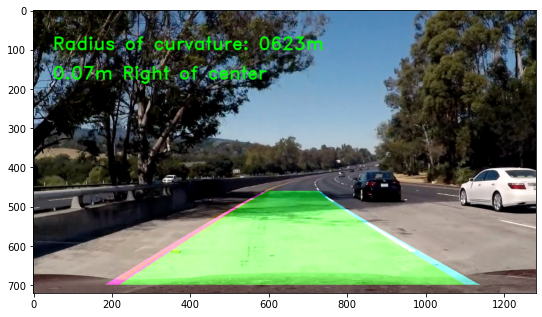

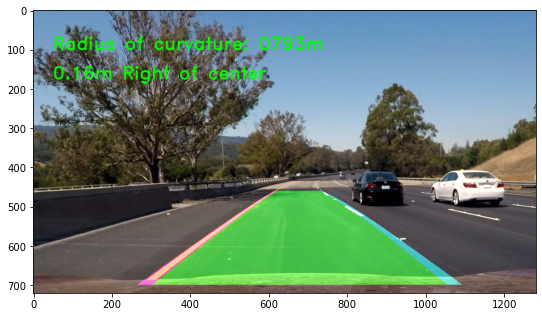

In [34]:
### testing final_pipline
for path in os.listdir(imgs_path):
    
    img = read_img(os.path.join(imgs_path,path))
    result = final_pipeline(img)

    # Let's plot the image
    plt.figure(figsize=(9,9))
    plt.imshow(result)

#### pipeline on Videos

In [35]:
if not os.path.exists('output_videos'):
    os.makedirs('output_videos')

In [36]:
vids = ['project_video', 'challenge_video', 'harder_challenge_video']

# choose here which video to process
chosen_vid = vids[0]

output = f'output_videos/chosen_vid.mp4'

clip1 = VideoFileClip(f'Project_data/{chosen_vid}.mp4')
# clip1 = VideoFileClip(f'project_data/{chosen_vid}.mp4').subclip(0,20)

# choose whether you want to debug the pipeline or not

clip = clip1.fl_image(final_debug_pipline)
# clip = clip1.fl_image(final_pipeline)

%time clip.write_videofile(output, audio=False)

Moviepy - Building video output_videos/chosen_vid.mp4.
Moviepy - Writing video output_videos/chosen_vid.mp4



Moviepy - Done !
Moviepy - video ready output_videos/chosen_vid.mp4
Wall time: 2min 4s


## Output Video

In [37]:
print(output)
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))

output_videos/chosen_vid.mp4


#### pipeline on images

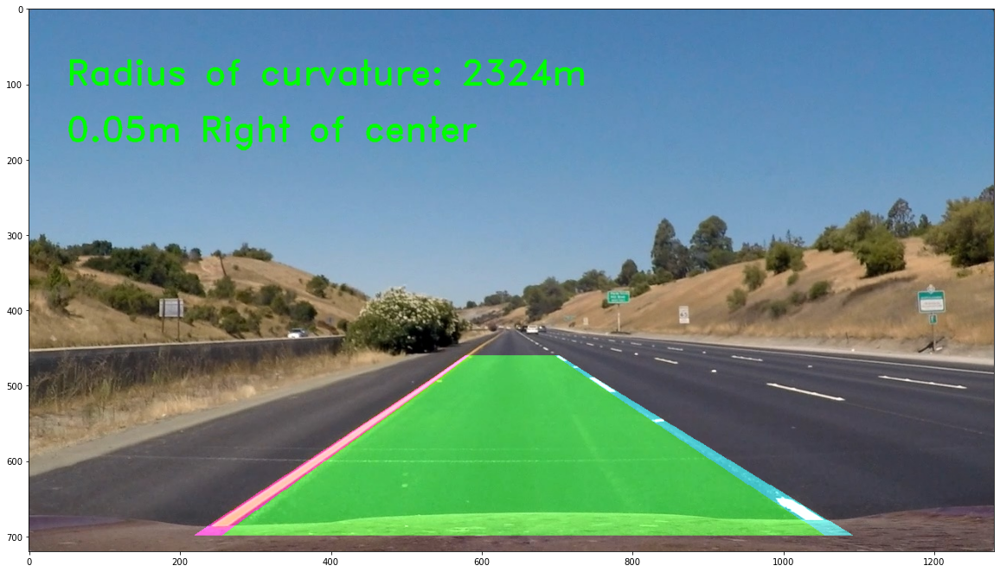

In [38]:
res_img =  final_pipeline(images[0])
plt.figure(figsize=(20,20))
plt.imshow(res_img)

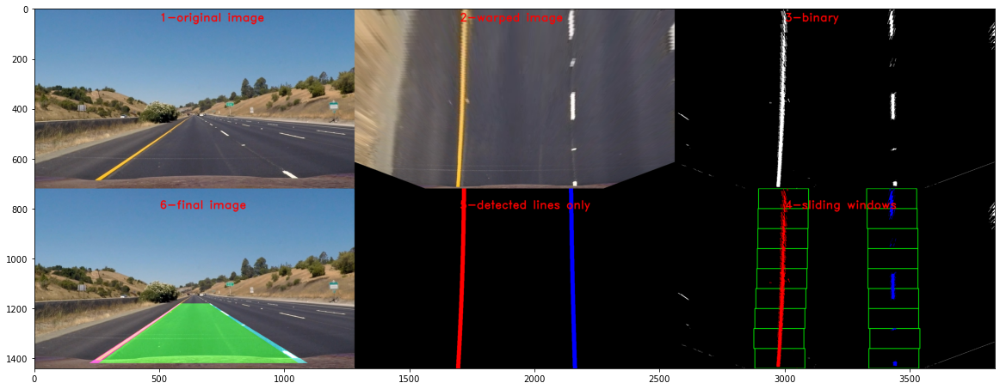

In [44]:
res_img =  final_debug_pipline(images[0])
plt.figure(figsize=(20,20))
plt.imshow(res_img)